In [1]:
## create trajectories
import pyarrow.csv as pc
import pyarrow as pa

# Define the path to your CSV file
csv_file = "./data/cleaned/1.csv"  # Change this to your actual file path

# Read the CSV file into a PyArrow Table
try:
    table = pc.read_csv(csv_file)
    print("CSV file successfully read into a PyArrow Table.")
except Exception as e:
    print(f"Error reading CSV file: {e}")
    exit()

# Print column names and their types
schema = table.schema
print("Columns and their types:")
for field in schema:
    print(f"{field.name}: {field.type}")

# Convert to a pandas DataFrame
df = table.to_pandas()
print("Converted to pandas DataFrame.")

# Display first few rows
print(df.head())

import numpy as np
import pandas as pd
import geopandas as gpd
import movingpandas as mpd
import shapely as shp
import hvplot.pandas
import matplotlib.pyplot as plt
import folium

from geopandas import GeoDataFrame, read_file
from shapely.geometry import Point, LineString, Polygon
from datetime import datetime, timedelta
from holoviews import opts, dim
from os.path import exists
from urllib.request import urlretrieve

import warnings

warnings.filterwarnings("ignore")
plot_defaults = {"linewidth": 5, "capstyle": "round", "figsize": (9, 3), "legend": True}
opts.defaults(
    opts.Overlay(active_tools=["wheel_zoom"], frame_width=500, frame_height=400)
)
hvplot_defaults = {"tiles": None, "cmap": "Viridis", "colorbar": True}

mpd.show_versions()



CSV file successfully read into a PyArrow Table.
Columns and their types:
Timestamp: timestamp[ns]
Type of mobile: string
MMSI: int64
Latitude: double
Longitude: double
Navigational status: string
ROT: double
SOG: double
COG: double
Heading: int64
IMO: int64
Callsign: string
Name: string
Ship type: string
Cargo type: string
Width: int64
Length: int64
Type of position fixing device: string
Draught: double
Destination: string
ETA: timestamp[s]
Data source type: string
A: int64
B: int64
C: int64
D: int64
__index_level_0__: int64
__index_level_0__: int64
Converted to pandas DataFrame.
   Timestamp Type of mobile       MMSI   Latitude  Longitude  \
0 2025-01-26        Class A  245241000  55.398643  14.711777   
1 2025-01-26        Class A  245241000  55.398643  14.711777   
2 2025-01-26        Class A  256883000  54.743528  16.130240   
3 2025-01-26        Class A  636020259  55.053283  14.032850   
4 2025-01-26        Class A  215662000  55.781642  15.883830   

      Navigational status  

/root/fun/ais/venv/lib/python3.12/site-packages/movingpandas/__init__.py:41: UserWarning: Missing optional dependencies. To use the trajectory smoother classes please install Stone Soup (see https://stonesoup.readthedocs.io/en/latest/#installation).
  warnings.warn(e.msg, UserWarning)



MovingPandas 0.21.2

SYSTEM INFO
-----------
python     : 3.12.3 (main, Jan 17 2025, 18:03:48) [GCC 13.3.0]
executable : /root/fun/ais/venv/bin/python3
machine    : Linux-6.8.0-49-generic-x86_64-with-glibc2.39

PROJ INFO
-----------
PROJ       : 9.4.1
PROJ data dir: /root/fun/ais/venv/lib/python3.12/site-packages/pyproj/proj_dir/share/proj

PYTHON DEPENDENCIES
-------------------
numpy      : 2.1.3
geopandas  : 1.0.1
geopy      : 2.4.1
geoviews   : 1.14.0
holoviews  : 1.20.0
hvplot     : 0.11.2
mapclassify: 2.8.1
matplotlib : 3.10.0
pandas     : 2.2.3
pyproj     : 3.7.0
shapely    : 2.0.7
stonesoup  : None


In [2]:
import geopandas as gpd
import movingpandas as mpd

print("Creating geometry column using vectorized function")
# Use GeoPandas' vectorized points_from_xy function to create the geometry column.
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.Longitude, df.Latitude),
    crs="EPSG:4326"
)
gdf = gdf.to_crs(epsg=4326)

print("Sorting on Timestamp")
# Ensure the Timestamp column is in datetime format, if not already.
gdf['Timestamp'] = pd.to_datetime(gdf['Timestamp'])
gdf = gdf.sort_values('Timestamp')

print("Creating trajectory collection")
# Create a MovingPandas TrajectoryCollection grouping by 'MMSI'.
trajectory_collection = mpd.TrajectoryCollection(gdf, 'MMSI', t='Timestamp')

print("TrajectoryCollection created successfully!")


Creating geometry column using vectorized function
Sorting on Timestamp
Creating trajectory collection
TrajectoryCollection created successfully!


TrajectoryCollection with 1127 trajectories
Trajectory 209217000 (2025-01-24 08:06:33 to 2025-01-24 20:16:22) | Size: 3990 | Length: 253604.3m
Bounds: (12.589927, 54.748267, 16.068258, 55.712225)
LINESTRING (16.068258 55.712225, 16.06655 55.711897, 16.06454 55.711542, 16.061777 55.711032, 16.060


:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Path.I   :Path   [Longitude,Latitude]
   .Points.I :Points   [Longitude,Latitude]   (triangle_angle)

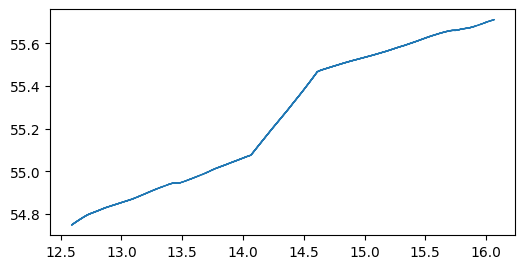

In [10]:
print(trajectory_collection)
my_traj = trajectory_collection.trajectories[10]
print(my_traj)
my_traj.plot(linewidth=1, capstyle="round", figsize=(6, 4))
my_traj.hvplot(line_width=5.0, tiles="OSM")


In [9]:
le = trajectory_collection.filter("Ship type", "Passenger")
le.hvplot(
    title="Passenger", line_width=2, frame_width=540, frame_height=480
)

:Overlay
   .WMTS.I         :WMTS   [Longitude,Latitude]
   .Path.I         :Path   [Longitude,Latitude]
   .Path.II        :Path   [Longitude,Latitude]
   .Path.III       :Path   [Longitude,Latitude]
   .Path.IV        :Path   [Longitude,Latitude]
   .Path.V         :Path   [Longitude,Latitude]
   .Path.VI        :Path   [Longitude,Latitude]
   .Path.VII       :Path   [Longitude,Latitude]
   .Path.VIII      :Path   [Longitude,Latitude]
   .Path.IX        :Path   [Longitude,Latitude]
   .Path.X         :Path   [Longitude,Latitude]
   .Path.XI        :Path   [Longitude,Latitude]
   .Path.XII       :Path   [Longitude,Latitude]
   .Path.XIII      :Path   [Longitude,Latitude]
   .Path.XIV       :Path   [Longitude,Latitude]
   .Path.XV        :Path   [Longitude,Latitude]
   .Path.XVI       :Path   [Longitude,Latitude]
   .Path.XVII      :Path   [Longitude,Latitude]
   .Path.XVIII     :Path   [Longitude,Latitude]
   .Path.XIX       :Path   [Longitude,Latitude]
   .Path.XX        :Path   [Longitude,Latitude]
   .Path.XXI       :Path   [Longitude,Latitude]
   .Path.XXII      :Path   [Longitude,Latitude]
   .Path.XXIII     :Path   [Longitude,Latitude]
   .Path.XXIV      :Path   [Longitude,Latitude]
   .Path.XXV       :Path   [Longitude,Latitude]
   .Path.XXVI      :Path   [Longitude,Latitude]
   .Path.XXVII     :Path   [Longitude,Latitude]
   .Path.XXVIII    :Path   [Longitude,Latitude]
   .Path.XXIX      :Path   [Longitude,Latitude]
   .Path.XXX       :Path   [Longitude,Latitude]
   .Path.XXXI      :Path   [Longitude,Latitude]
   .Path.XXXII     :Path   [Longitude,Latitude]
   .Path.XXXIII    :Path   [Longitude,Latitude]
   .Path.XXXIV     :Path   [Longitude,Latitude]
   .Path.XXXV      :Path   [Longitude,Latitude]
   .Path.XXXVI     :Path   [Longitude,Latitude]
   .Path.XXXVII    :Path   [Longitude,Latitude]
   .Path.XXXVIII   :Path   [Longitude,Latitude]
   .Path.XXXIX     :Path   [Longitude,Latitude]
   .Path.XL        :Path   [Longitude,Latitude]
   .Path.XLI       :Path   [Longitude,Latitude]
   .Points.I       :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.II      :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.III     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.IV      :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.V       :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VI      :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VII     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VIII    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.IX      :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.X       :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XI      :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XII     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XIII    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XIV     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XV      :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XVI     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XVII    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XVIII   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XIX     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XX      :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXI     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXII    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXIII   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXIV    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXV     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXVI    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXVII   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXVIII  :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXIX    :Points   [Longitude,Lat

In [31]:
my_traj2 = trajectory_collection.trajectories[9]
my_traj2.explore(
    column="SOG", cmap="plasma", tiles="CartoDB positron", style_kwds={"weight": 9}
)

In [5]:
#gdf_small = le.to_traj_gdf()
#gdf_small.to_file("test_traj.geojson", driver="GeoJSON")  
my_traj.explore(
    column="MMSI",
    cmap="turbo",
    tiles="CartoDB positron",
    tooltip="MMSI",
    popup=True,
    legend=False,
)

In [6]:
for traj in le:
    print(traj)

NameError: name 'le' is not defined